<a href="https://colab.research.google.com/github/eshaan2/Yolov5_model_for_Histopathological_data/blob/main/Object_Detection_using_Yolov5_for_Histopathological_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##MODULE REQUIRED IS CALLED:



In [2]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

np.random.seed(42)

In [3]:
!ls

drive  sample_data


## Hyperparameters and Constants

Here, we define wether to train the model or not and for how many epochs to train for.

If `TRAIN = False`, then the last trained model will be used for inference in the notebook if run end to end.

In [4]:
# if not os.path.exists('train'):
#     !curl -L "https://public.roboflow.com/ds/xKLV14HbTF?key=aJzo7msVta" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

#     dirs = ['train', 'valid', 'test']

#     for i, dir_name in enumerate(dirs):
#         all_image_names = sorted(os.listdir(f"{dir_name}/images/"))
#         for j, image_name in enumerate(all_image_names):
#             if (j % 2) == 0:
#                 file_name = image_name.split('.jpg')[0]
#                 os.remove(f"{dir_name}/images/{image_name}")
#                 os.remove(f"{dir_name}/labels/{file_name}.txt")

In [5]:
TRAIN = True
# Number of epochs to train for.
#EPOCHS = 50 #Originally used epochs.We can run the Code for more Epochs. More the Epochs better is the result(which is the model gets trained better)
EPOCHS = 50 #Alternate

## Download and Prepare the Dataset

We will use the dataset for training the custom YOLOv5 object detector.

In [6]:

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


The original data had two instances of each image and label file. The rest of the code in the above block deletes the duplicate image and it's corresponding text file containing the label.

The dataset is structured in the following manner:

```
├── data.yaml
├── README.dataset.txt
├── README.roboflow.txt
├── test
│   ├── images
│   └── labels
├── train
│   ├── images
│   └── labels
└── valid
    ├── images
    └── labels

```

## Helper Functions to Download Files

The following function is for downloading any file in the notebook. In further sections of the notebook, we will use it for downloading the inference data.

In [ ]:
#def download_file(url, save_name):
    #url = url
    #if not os.path.exists(save_name):
        #file = requests.get(url)
        #open(save_name, 'wb').write(file.content)
    #else:
        #print('File already present, skipping download...')

### The Dataset YAML File

The dataset YAML (`data.yaml`) file containing the path to the training and validation images and labels is already provided. This file will also contain the class names from the dataset.

The dataset contains 1 classes: **'Mitosis'**.

The following block shows the contents of the `data.yaml` file.

```yaml
train: /content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/Train_img_label
val: /content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/Validation_img_label

nc: 1
names: ['Mitosis']
```

### Visualize a Few Ground Truth Images

Before moving forward, let's check out few of the ground truth images.

The current annotations in the text files are in normalized `[x_center, y_center, width, height]` format. Let's write a function that will convert it back to `[x_min, y_min, x_max, y_max]` format.

In [7]:
class_names = ['Mitosis']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [8]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [9]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin

        class_name = class_names[int(labels[box_num])]

        cv2.rectangle(
            image,
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        )

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name,
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image,
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image,
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [10]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()

    num_images = len(all_training_images)

    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

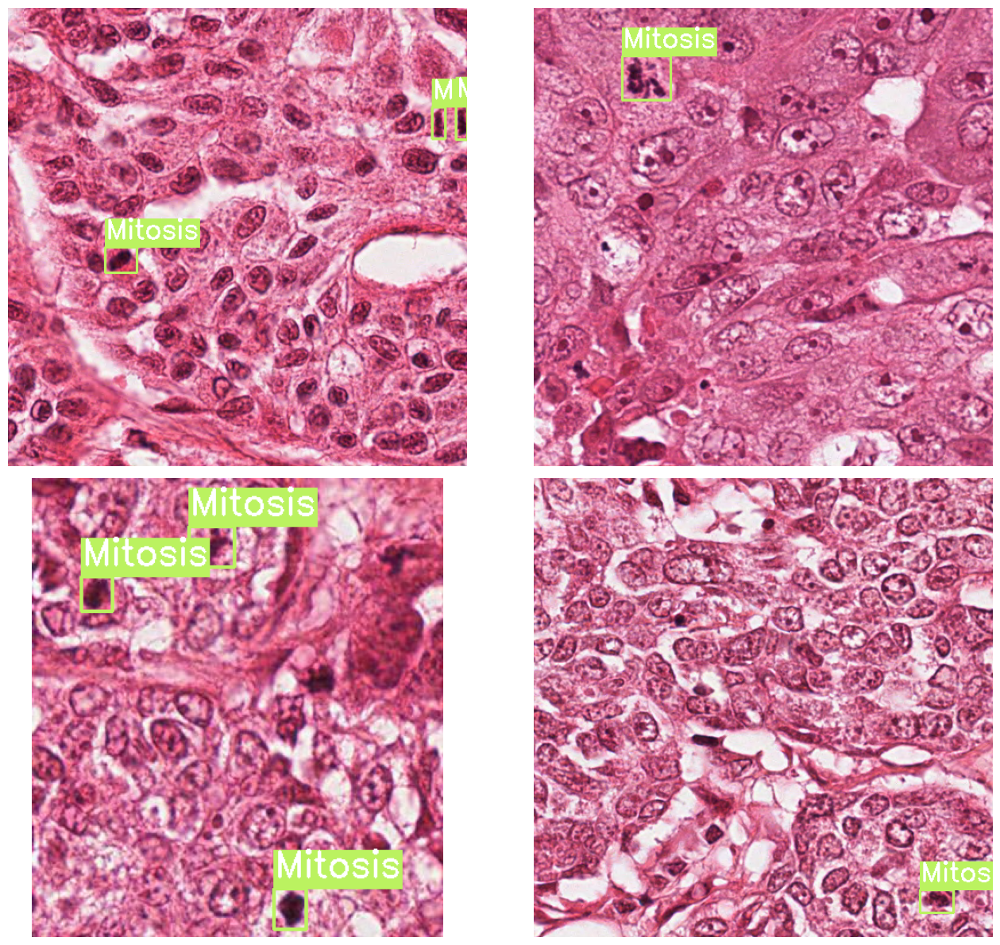

In [11]:
# Visualize a few training images.
plot(
    image_paths='/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/Train/Mitosis_Train_image/*',
    label_paths='/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/Train/Mitosis_Train_label/*',
    num_samples=4
)

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Helper Functions for Logging

Here, we write the helper functions that we need for logging of the results in the notebook while training the models.

Let's create our custom result directories so that we can easily keep track of them and carry out inference using the proper model.

In [12]:
!pwd

/content


In [13]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('/runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

**Function to Monitor TensorBoard logs**.

In [14]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

## Clone YOLOV5 Repository

In [15]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 15829, done.
remote: Counting objects: 100% (61/61), done.
remote: Compressing objects: 100% (57/57), done.
remote: Total 15829 (delta 20), reused 29 (delta 4), pack-reused 15768
Receiving objects: 100% (15829/15829), 14.66 MiB | 27.90 MiB/s, done.
Resolving deltas: 100% (10829/10829), done.


In [16]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [17]:
!pip install -r requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.5/188.5 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 605.0/605.0 kB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.5 MB/s eta 0:00:00


In [18]:
!pwd

/content/yolov5


## Training using YOLOV5

The next step is to train the neural network model.

In [19]:
monitor_tensorboard()

<IPython.core.display.Javascript object>

### Train a Small (yolov5s) Model

Training all the layers of the small model.

In [20]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 8241), started 0:01:07 ago. (Use '!kill 8241' to kill it.)

<IPython.core.display.Javascript object>

In [22]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data /content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/data.yaml --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 5 --name {RES_DIR}

Current number of result directories: 0
results_1
WARNING ⚠️ 'ultralytics.yolo.v8' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.models.yolo' instead.
WARNING ⚠️ 'ultralytics.yolo.utils' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.utils' instead.
Note this warning may be related to loading older models. You can update your model to current structure with:
    import torch
    ckpt = torch.load("model.pt")  # applies to both official and custom models
    torch.save(ckpt, "updated-model.pt")

train: weights=yolov5s.pt, cfg=, data=/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=5, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/trai

In [23]:
!ls -a

.		 .dockerignore	 models			  setup.cfg
..		 export.py	 .pre-commit-config.yaml  train.py
benchmarks.py	 .git		 __pycache__		  tutorial.ipynb
CITATION.cff	 .gitattributes  README.md		  utils
classify	 .github	 README.zh-CN.md	  val.py
CONTRIBUTING.md  .gitignore	 requirements.txt	  yolov5s.pt
data		 hubconf.py	 runs
detect.py	 LICENSE	 segment


## Check Out the Validation Predictions and Inference

In this section, we will check out the predictions of the validation images saved during training. Along with that, we will also check out inference of images and videos.

### Visualization and Inference Utilities

We will visualize the validation prediction images that are saved during training. The following is the function for that.

In [24]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

The following functions are for carrying out inference on images.

In [25]:
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

We may also need to visualize images in any of the directories. The following function accepts a directory path and plots all the images in them.

In [26]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.tif")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

**Visualize validation prediction images.**

confusion_matrix.png				    results.png
events.out.tfevents.1690565853.c79aeaa041fb.8862.0  train_batch0.jpg
F1_curve.png					    train_batch1.jpg
hyp.yaml					    train_batch2.jpg
labels_correlogram.jpg				    val_batch0_labels.jpg
labels.jpg					    val_batch0_pred.jpg
opt.yaml					    val_batch1_labels.jpg
P_curve.png					    val_batch1_pred.jpg
PR_curve.png					    val_batch2_labels.jpg
R_curve.png					    val_batch2_pred.jpg
results.csv					    weights
['runs/train/results_1/val_batch0_pred.jpg', 'runs/train/results_1/val_batch1_pred.jpg', 'runs/train/results_1/val_batch2_pred.jpg']


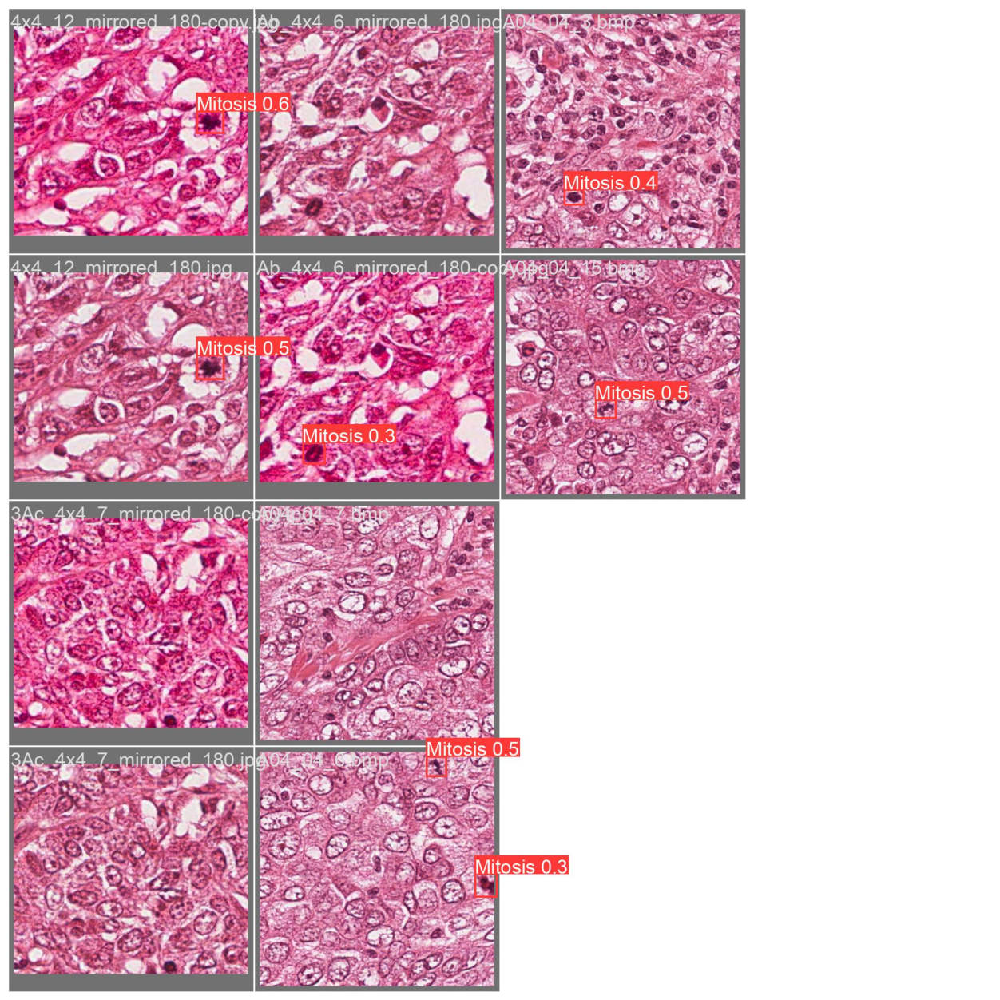

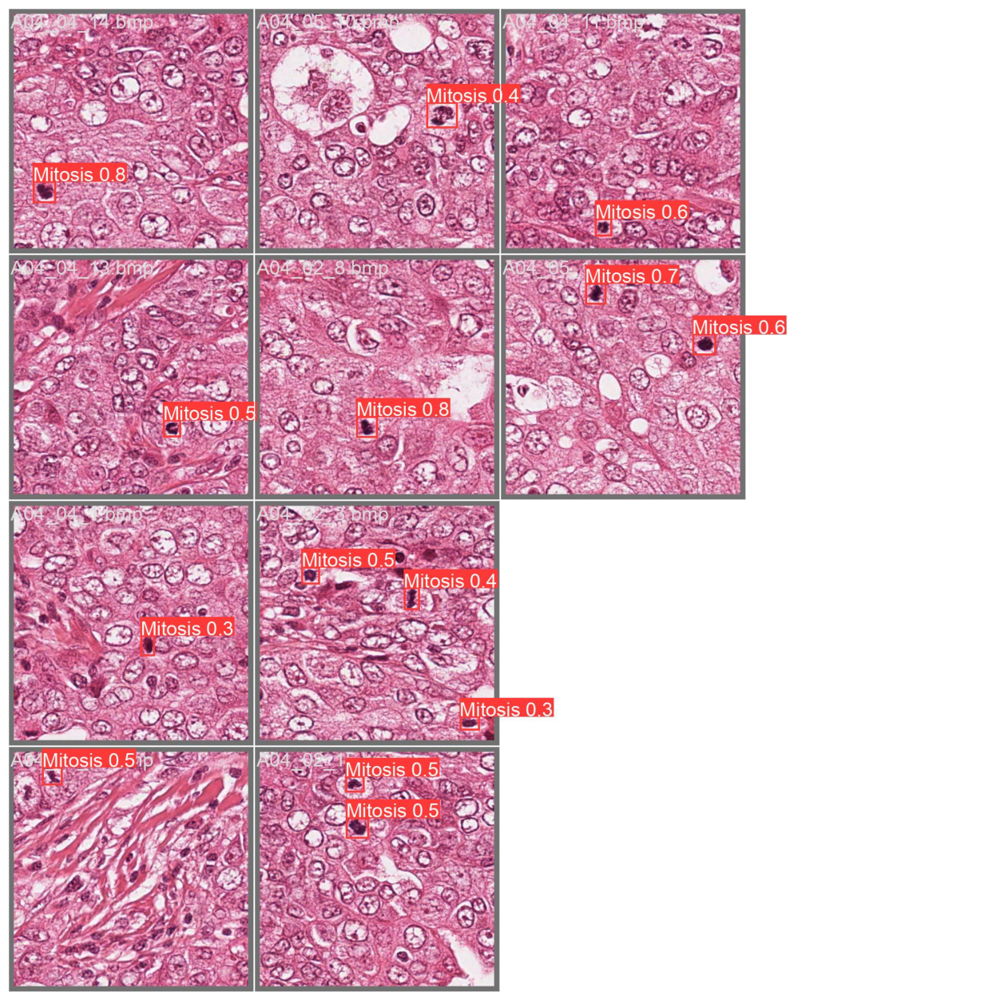

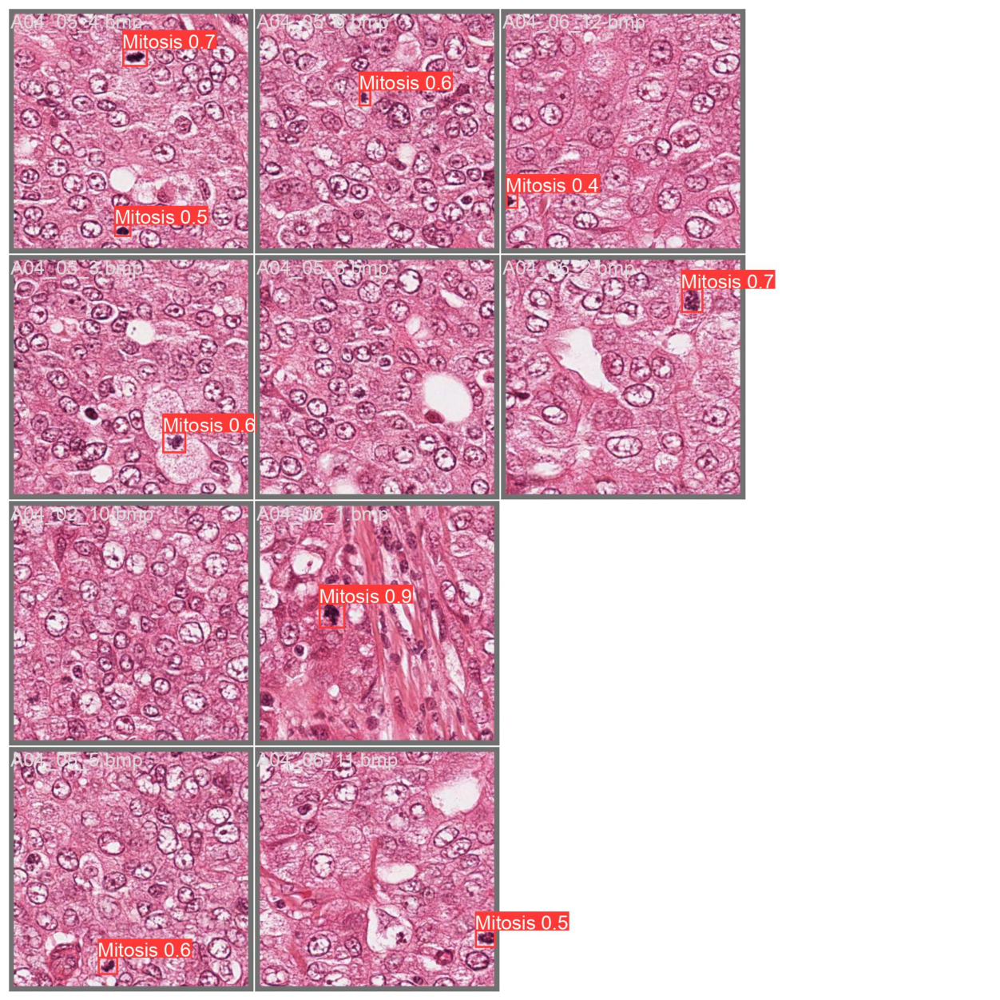

In [27]:
show_valid_results(RES_DIR)

### Inference
In this section, we will carry out inference on unseen images and videos from the internet.

The images for inference are in the `inference_images` directory.

The videos for inference are in the `inference_videos` directory.

### Download the Images
Let's download the images that we will carry inference upon.

In [ ]:
# download_file('https://learnopencv.s3.us-west-2.amazonaws.com/yolov5_inference_data.zip',
#               'inference_data.zip')
# if not os.path.exists('inference_images'):
#     !unzip -q "inference_data.zip"
# else:
#     print('Dataset already present')

### Inference on Images

**To carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.**

In [28]:
# Inference on images.
import time
start = time.time()
IMAGE_INFER_DIR = inference(RES_DIR, '/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/Test')
print("processing time: ", time.time() - start)

Current number of inference detection directories: 0
inference_1
WARNING ⚠️ 'ultralytics.yolo.v8' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.models.yolo' instead.
WARNING ⚠️ 'ultralytics.yolo.utils' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.utils' instead.
Note this warning may be related to loading older models. You can update your model to current structure with:
    import torch
    ckpt = torch.load("model.pt")  # applies to both official and custom models
    torch.save(ckpt, "updated-model.pt")

detect: weights=['runs/train/results_1/weights/best.pt'], source=/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/Test, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, nam

In [29]:
visualize(IMAGE_INFER_DIR)

[]


### Visualization and Inference Utilities


## Training and Inference using  Medium Model

In [ ]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 6144), started 0:16:49 ago. (Use '!kill 6144' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!ls -a

.		 .dockerignore	 models			  setup.cfg
..		 export.py	 .pre-commit-config.yaml  train.py
benchmarks.py	 .git		 __pycache__		  tutorial.ipynb
CITATION.cff	 .gitattributes  README.md		  utils
classify	 .github	 README.zh-CN.md	  val.py
CONTRIBUTING.md  .gitignore	 requirements.txt	  yolov5m.pt
data		 hubconf.py	 runs			  yolov5s.pt
detect.py	 LICENSE	 segment


In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data /content/drive/MyDrive/Internship/Dataset_kmc_Imp/Data_kmc/data_KMC.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 8 --name {RES_DIR}

Current number of result directories: 0
results_1
train: weights=yolov5m.pt, cfg=, data=/content/drive/MyDrive/Internship/Dataset_kmc_Imp/Data_kmc/data_KMC.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-187-g0004c74 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, 

In [ ]:
# Inference on images.
import time
start = time.time()
IMAGE_INFER_DIR = inference(RES_DIR, '/content/drive/MyDrive/Internship/Dataset_kmc_Imp/Data_kmc/test_kmc')
print("processing time: ", time.time() - start)


In [ ]:
visualize(IMAGE_INFER_DIR)

[]


## Freezing Layers and Training the Medium Model

The Medium model (yolov5m) contains 25 blocks layers in total more than 20 million parameters. We need not train all the layers. Let's freeze a few layers and train again. This will result in faster iteration per epoch. Here, we freeze the first 15 blocks.

In [30]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 8241), started 0:12:44 ago. (Use '!kill 8241' to kill it.)

<IPython.core.display.Javascript object>

In [31]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data /content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/data.yaml  --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 5 --name {RES_DIR} \
    --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

Current number of result directories: 0
results_1
WARNING ⚠️ 'ultralytics.yolo.v8' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.models.yolo' instead.
WARNING ⚠️ 'ultralytics.yolo.utils' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.utils' instead.
Note this warning may be related to loading older models. You can update your model to current structure with:
    import torch
    ckpt = torch.load("model.pt")  # applies to both official and custom models
    torch.save(ckpt, "updated-model.pt")

train: weights=yolov5m.pt, cfg=, data=/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=5, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/trai

In [32]:
# Inference on images.
import time
start = time.time()
IMAGE_INFER_DIR = inference(RES_DIR, '/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/Test')
print("processing time: ", time.time() - start)

Current number of inference detection directories: 1
inference_2
WARNING ⚠️ 'ultralytics.yolo.v8' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.models.yolo' instead.
WARNING ⚠️ 'ultralytics.yolo.utils' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.utils' instead.
Note this warning may be related to loading older models. You can update your model to current structure with:
    import torch
    ckpt = torch.load("model.pt")  # applies to both official and custom models
    torch.save(ckpt, "updated-model.pt")

detect: weights=['runs/train/results_1/weights/best.pt'], source=/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/Test, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, nam

In [33]:
visualize(IMAGE_INFER_DIR)

[]


In [34]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data /content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/data.yaml  --weights yolov5l.pt \
    --img 640 --epochs {EPOCHS} --batch-size 8 --name {RES_DIR}

Current number of result directories: 0
results_1
WARNING ⚠️ 'ultralytics.yolo.v8' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.models.yolo' instead.
WARNING ⚠️ 'ultralytics.yolo.utils' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.utils' instead.
Note this warning may be related to loading older models. You can update your model to current structure with:
    import torch
    ckpt = torch.load("model.pt")  # applies to both official and custom models
    torch.save(ckpt, "updated-model.pt")

train: weights=yolov5l.pt, cfg=, data=/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/trai

In [35]:
# Inference on images.
import time
start = time.time()
IMAGE_INFER_DIR = inference(RES_DIR, '/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/Test')
print("processing time: ", time.time() - start)

Current number of inference detection directories: 2
inference_3
WARNING ⚠️ 'ultralytics.yolo.v8' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.models.yolo' instead.
WARNING ⚠️ 'ultralytics.yolo.utils' is deprecated since '8.0.136' and will be removed in '8.1.0'. Please use 'ultralytics.utils' instead.
Note this warning may be related to loading older models. You can update your model to current structure with:
    import torch
    ckpt = torch.load("model.pt")  # applies to both official and custom models
    torch.save(ckpt, "updated-model.pt")

detect: weights=['runs/train/results_1/weights/best.pt'], source=/content/drive/MyDrive/ICPR14_DATASET/ICPR14_DATASET/Test, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, nam

In [36]:
visualize(IMAGE_INFER_DIR)

[]


In [ ]:
import tensorflow as tf

print("TensorFlow version:", tf.__version__)

TensorFlow version: 2.12.0


In [ ]:
import sys

print("Python version:", sys.version)


Python version: 3.10.12 (main, Jun  7 2023, 12:45:35) [GCC 9.4.0]
